# Annotations using clustering for cells for breast_s0

In [1]:
slide_id = "breast_s0"

In [2]:
import pandas as pd
import scanpy as sc
import spatialdata as sd
import decoupler as dc
from collections import Counter
from bioservices.kegg import KEGG

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## 1. Load the data

In [3]:
sdata = sd.read_zarr(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_{slide_id}.zarr")
sdata

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/spatialdata/_core/spatialdata.py:158: UserWarning: The table is annotating 'cell_labels', which is not present in the SpatialData object.
  self.validate_table_in_spatialdata(v)


SpatialData object, with associated Zarr store: /Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_breast_s0.zarr
├── Images
│     └── 'he': DataTree[cyx] (3, 53833, 48441), (3, 26916, 24220)
├── Points
│     └── 'st': DataFrame with shape: (<Delayed>, 10) (3D points)
├── Shapes
│     ├── 'cell_boundaries': GeoDataFrame shape: (576963, 1) (2D shapes)
│     └── 'nucleus_boundaries': GeoDataFrame shape: (576963, 1) (2D shapes)
└── Tables
      ├── 'table_cells': AnnData (576963, 380)
      └── 'table_nuclei': AnnData (576963, 541)
with coordinate systems:
    ▸ '_st_intrinsic', with elements:
        st (Points)
    ▸ 'global', with elements:
        he (Images), st (Points), cell_boundaries (Shapes), nucleus_boundaries (Shapes)

In [4]:
adata_cells_ini = sdata.tables['table_cells'].copy()
adata_cells_ini

AnnData object with n_obs × n_vars = 576963 × 380
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatialdata_attrs'
    obsm: 'spatial'

In [5]:
adata_cells_ini.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,total_counts,cell_area,nucleus_area,region
0,aaaaaaaa-1,57,0,0,0,57,277.936719,29.216094,cell_labels
1,aaaaaaab-1,88,0,0,0,88,687.955469,37.840938,cell_labels
2,aaaaaaac-1,190,0,0,0,190,223.342813,29.216094,cell_labels
3,aaaaaaad-1,146,0,0,0,146,96.995625,21.900781,cell_labels
4,aaaaaaae-1,203,0,0,0,203,115.012969,44.162813,cell_labels
...,...,...,...,...,...,...,...,...,...
576958,aaaimnlo-1,90,0,0,0,90,50.981406,31.654531,cell_labels
576959,aaaimnlp-1,96,0,0,0,96,47.007656,32.106094,cell_labels
576960,aaaimnma-1,178,0,0,0,178,90.222188,59.741719,cell_labels
576961,aaaimnmb-1,50,0,0,0,50,83.584219,13.953281,cell_labels


In [6]:
adata_cells_ini.var

,gene_ids,feature_types,genome
ABCC11,ENSG00000121270,Gene Expression,Unknown
ACKR1,ENSG00000213088,Gene Expression,Unknown
ACTA2,ENSG00000107796,Gene Expression,Unknown
ACTG2,ENSG00000163017,Gene Expression,Unknown
ADAM9,ENSG00000168615,Gene Expression,Unknown
...,...,...,...
WARS,ENSG00000140105,Gene Expression,Unknown
XCR1,ENSG00000173578,Gene Expression,Unknown
ZEB1,ENSG00000148516,Gene Expression,Unknown
ZEB2,ENSG00000169554,Gene Expression,Unknown


In [4]:
adata_nuclei = sc.read_h5ad(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")
adata_nuclei

AnnData object with n_obs × n_vars = 542818 × 541
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram', 'transcript_counts', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6', 'refine_res', 'label1', 'label2', 'label3'
    var: 'mean', 'std'
    uns: 'ct_tangram_colors', 'label1_colors', 'label2_colors', 'label3_colors', 'log1p', 'pca', 'pca_n10_pcs16', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.2_colors', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.4_colors', 'pca_n10_pcs16_leiden_res0.6', 'pca_n10_pcs16_leiden_res0.6_colors', 'rank_genes_pca_n10_pcs16_leiden_res0.2', 'rank_genes_pca_n10_pcs16_leiden_res0.4', 'rank_genes_refine_res', 'refine_res_colors', 'sopa_attrs', 'spatialdata_attrs', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'tangram_pred'
    varm: 'PCs'
    layers: 'count', 'log_norm'
    obsp: 'pca_n10_pcs16_connectivities', 'pca_n10_pcs16_distances'

In [8]:
adata_nuclei.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,label3
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,39.195546,Mast cell,13,6,5,1,5,Epithelial,Proliferating_mammary_luminal_epithelial_cell,cancer_cell
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,35.628433,ILC,25,4,9,13,9,Epithelial,Mammary_luminal_cell,cancer_cell
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,27.475306,CXCL+ fibroblast,73,1,1,2,1,Fibroblast,CAF,normal_cell
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,20.115325,CXCL14 mammary basal cell,50,0,0,0,0,Epithelial,Mammary_luminal_cell,cancer_cell
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,41.472044,Capillary EC,143,0,0,0,0,Epithelial,Mammary_luminal_cell,cancer_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...
aaaimnlo-1,nucleus_boundaries,morpho,aaaimnlo-1,30.208380,Vascular smooth muscle cell,75,0,0,0,0,Epithelial,Mammary_luminal_cell,cancer_cell
aaaimnlp-1,nucleus_boundaries,morpho,aaaimnlp-1,31.361348,Secretoglobin mammary luminal cell,87,0,0,0,0,Epithelial,Mammary_luminal_cell,cancer_cell
aaaimnma-1,nucleus_boundaries,morpho,aaaimnma-1,55.811864,SFN mammary luminal progenitor,158,0,0,0,0,Epithelial,Mammary_luminal_cell,cancer_cell
aaaimnmb-1,nucleus_boundaries,morpho,aaaimnmb-1,12.621063,Mast cell,28,0,2,1,2,Epithelial,Mammary_basal_and_luminal_cell,normal_cell


In [9]:
adata_nuclei.var

,mean,std
ABCC11,1.316181,2.301424
ACKR1,0.061929,0.587239
ACTA2,1.504025,2.485627
ACTG2,0.389850,1.355296
ADAM9,1.457810,2.292761
...,...,...
WARS,0.476682,1.446856
XCR1,0.014502,0.268111
ZEB1,0.424827,1.441365
ZEB2,0.842093,2.014793


## 2. Preprocessing

<Axes: >

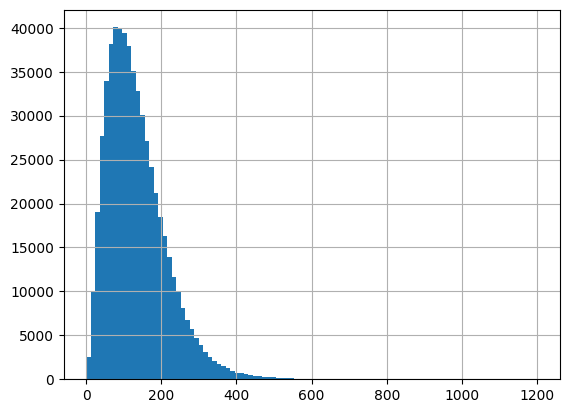

In [10]:
adata_cells_ini.obs['transcript_counts'].hist(bins=100)

<Axes: >

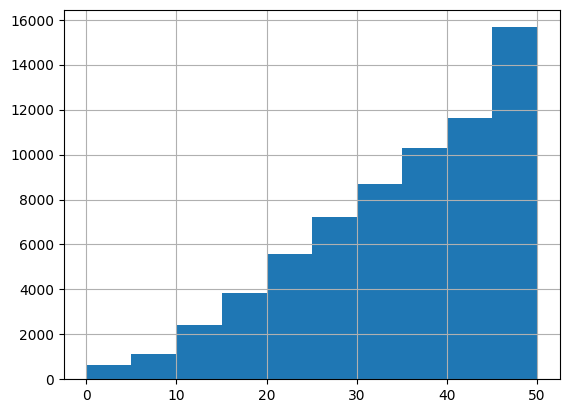

In [11]:
# in range 0-50
adata_cells_ini.obs['transcript_counts'].hist(range=(0,50))

In [12]:
print(f"Number of cells with less than 20 transcripts: {(adata_cells_ini.obs['transcript_counts']<20).sum()}")
print(f"Percentage of cells with less than 20 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<20).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 15 transcripts: {(adata_cells_ini.obs['transcript_counts']<15).sum()}")
print(f"Percentage of cells with less than 15 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<15).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 10 transcripts: {(adata_cells_ini.obs['transcript_counts']<10).sum()}")
print(f"Percentage of cells with less than 10 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<10).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number total of cells: {len(adata_cells_ini.obs)}")

Number of cells with less than 20 transcripts: 7987
Percentage of cells with less than 20 transcripts: 1.38%
-----
Number of cells with less than 15 transcripts: 4144
Percentage of cells with less than 15 transcripts: 0.72%
-----
Number of cells with less than 10 transcripts: 1734
Percentage of cells with less than 10 transcripts: 0.3%
-----
Number total of cells: 576963


In [13]:
adata_cells =  adata_cells_ini[adata_cells_ini.obs['transcript_counts']>10].copy()
print(len(adata_cells.obs))

574869


In [14]:
# Save the raw data
adata_cells.layers['count'] = adata_cells.X.copy()

In [15]:
# Normalize
sc.pp.normalize_total(adata_cells, target_sum=1e4)
sc.pp.log1p(adata_cells)
adata_cells.layers['log_norm'] = adata_cells.X.copy()

In [16]:
# Scale each gene to unit variance. Clip values exceeding standard deviation 10.
sc.pp.scale(adata_cells, max_value=10)

## 3. Principal component analysis

In [17]:
# Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.
sc.tl.pca(adata_cells, svd_solver="arpack", use_highly_variable=False)

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:385: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


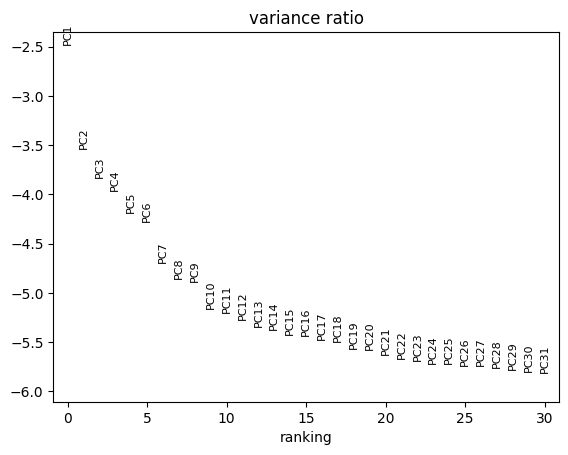

In [18]:
# Contribution of single PCs to the total variance in the data
# This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`
sc.pl.pca_variance_ratio(adata_cells, log=True)

In [19]:
adata_cells

AnnData object with n_obs × n_vars = 574869 × 380
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region'
    var: 'gene_ids', 'feature_types', 'genome', 'mean', 'std'
    uns: 'spatialdata_attrs', 'log1p', 'pca'
    obsm: 'spatial', 'X_pca'
    varm: 'PCs'
    layers: 'count', 'log_norm'

In [20]:
# Restore X to be log norm counts
# /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
dc.swap_layer(adata_cells, 'log_norm', X_layer_key=None, inplace=True)

## 4. The neighborhood graph + clustering

In [21]:
# Neighborhood graph of cells using the PCA representation of the data matrix
sc.pp.neighbors(adata_cells, n_neighbors=10, n_pcs=16, use_rep="X_pca", key_added='pca_n10_pcs16')
# Embedding the neighborhood graph using UMAP
sc.tl.umap(adata_cells, neighbors_key='pca_n10_pcs16')
# Leiden clustering directly clusters the neighborhood graph of cells
sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata_cells, resolution=0.4, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.4', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata_cells, resolution=0.6, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.6', neighbors_key='pca_n10_pcs16')

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_4349/1436083260.py:6: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')


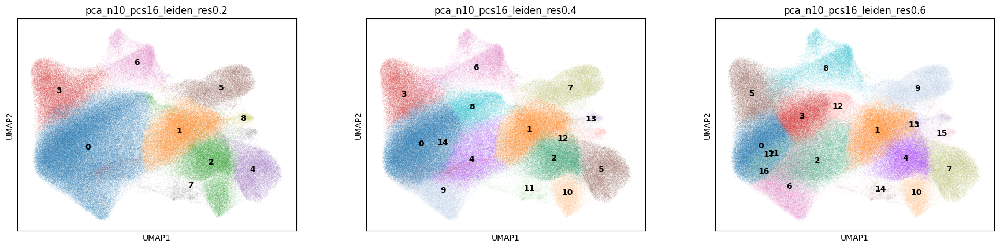

In [22]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs16',
           color=['pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6'],
           ncols=3, legend_loc='on data')

In [23]:
# Number of clusters
adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].unique()

['0', '3', '5', '4', '2', '1', '6', '8', '7']
Categories (9, object): ['0', '1', '2', '3', ..., '5', '6', '7', '8']

In [89]:
# Refine resolution
adata_cells.obs['refine_res'] = 'att'

adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['0']), 'refine_res'] = '0'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['1']), 'refine_res'] = '1'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['2']), 'refine_res'] = '2'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['3']), 'refine_res'] = '3'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['4']), 'refine_res'] = '4'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['5']), 'refine_res'] = '5'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['6']), 'refine_res'] = '6'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['7']), 'refine_res'] = '7'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['8']), 'refine_res'] = '8'

adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['10']), 'refine_res'] = '9'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['15']), 'refine_res'] = '10'

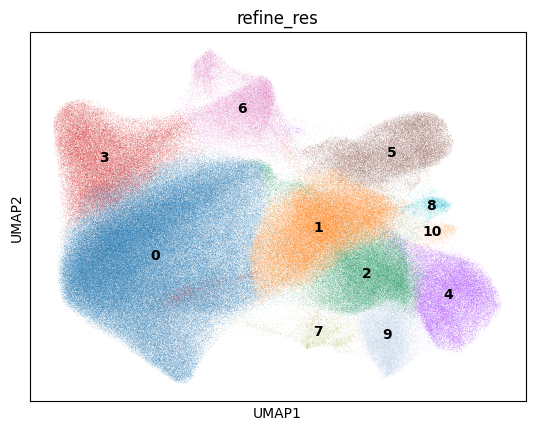

In [90]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs16', color=['refine_res'], legend_loc='on data')

## 5. Name clusters

**To go from specific gene marker to cell type: http://xteam.xbio.top/CellMarker/search.jsp?cellMarkerSpeciesType=Human&cellMarker=CD5L**

In [91]:
clustering_label = 'refine_res'

In [92]:
merged_df = pd.merge(adata_cells.obs[['cell_id', 'refine_res']].copy(), adata_nuclei.obs[['cell_id', 'label1', 'label2', 'label3']].copy(), on='cell_id', how='outer')

for col in ['label1', 'label2', 'label3']:
    if merged_df[col].dtype.name == 'category':  # Check if already categorical
        merged_df[col] = merged_df[col].cat.add_categories('NA')  # Add 'NA' as a category
merged_df[['label1', 'label2', 'label3']] = merged_df[['label1', 'label2', 'label3']].fillna('NA')

merged_df['label_combined'] = merged_df[['label1', 'label2', 'label3']].apply(lambda x: '&'.join(x.astype(str)), axis=1)

def compare_with_nuclei(merged_df, cluster_id):

    df_filtered = merged_df[merged_df['refine_res'] == cluster_id]
    label_counts = df_filtered['label_combined'].value_counts(normalize=True)
    top_5 = label_counts.head(5)

    top_5_df = top_5.reset_index()
    top_5_df.columns = ['label_combined', 'percentage']
    
    labels_split = top_5_df['label_combined'].str.split('&', expand=True)
    labels_split.columns = ['label1', 'label2', 'label3']

    top_5_df['percentage'] = (top_5_df['percentage'] * 100).round(1).astype(str)

    top_5_df_final = pd.concat([labels_split, top_5_df['percentage']], axis=1)
    
    return top_5_df_final

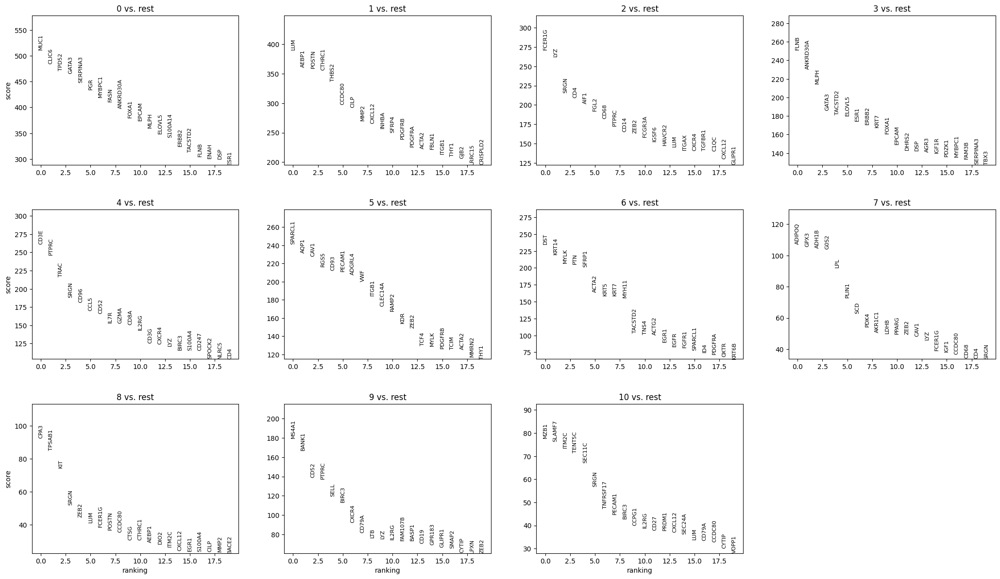

In [93]:
# Wilcoxon rank-sum (Mann-Whitney-U) test. 
# You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.
sc.tl.rank_genes_groups(adata_cells, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)
sc.pl.rank_genes_groups(adata_cells, n_genes=20, sharey=False, key="rank_genes_"+clustering_label)

In [94]:
# The top ranked genes per cluster
top_ranked_genes = pd.DataFrame(adata_cells.uns["rank_genes_"+clustering_label]["names"]).iloc[:5, :]
list_genes = pd.concat([top_ranked_genes[col] for col in top_ranked_genes], ignore_index=True).tolist()

In [95]:
adata_cells.obs['label1'] = 'att'
adata_cells.obs['label2'] = 'att'
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

### 5.1. Cluster 0

In [96]:
cluster_id = '0'

In [97]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Mammary_luminal_cell,cancer_cell,64.4
1,Epithelial,Mammary_basal_and_luminal_cell,normal_cell,19.2
2,Epithelial,Proliferating_mammary_luminal_epithelial_cell,cancer_cell,11.8
3,NA,NA,NA,3.4
4,Fibroblast,CAF,normal_cell,1.0


In [98]:
top_ranked_genes[cluster_id]

0        MUC1
1       CLIC6
2       TPD52
3       GATA3
4    SERPINA3
Name: 0, dtype: object

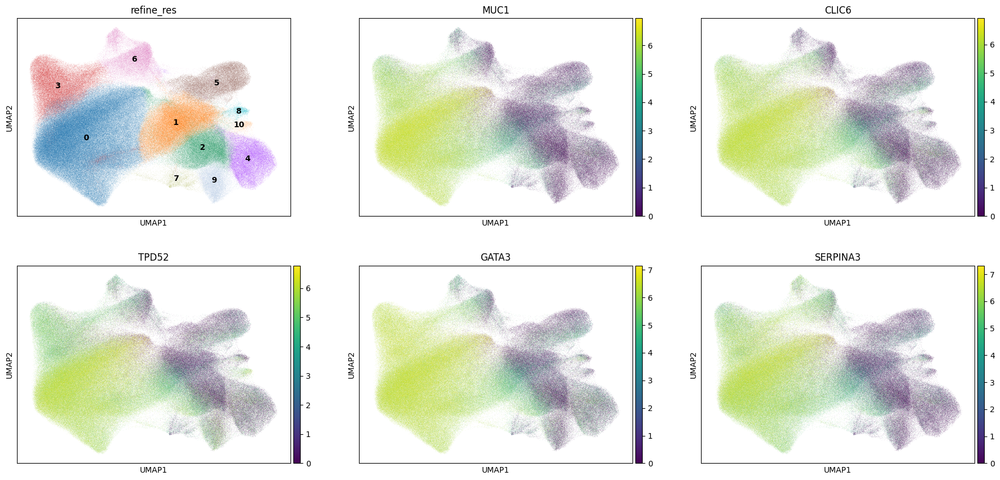

In [99]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [100]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 0: 262647
Percentage of cells in cluster 0: 45.7


In [101]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Mammary_luminal_cell'

### 5.2. Cluster 1

In [102]:
cluster_id = '1'

In [103]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Fibroblast,CAF,normal_cell,83.1
1,NA,NA,NA,7.9
2,Epithelial,Mammary_basal_and_luminal_cell,normal_cell,2.8
3,Perivascular,Smooth_muscle_cell_and_pericyte,normal_cell,2.0
4,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,1.6


In [104]:
top_ranked_genes[cluster_id]

0       LUM
1     AEBP1
2     POSTN
3    CTHRC1
4     THBS2
Name: 1, dtype: object

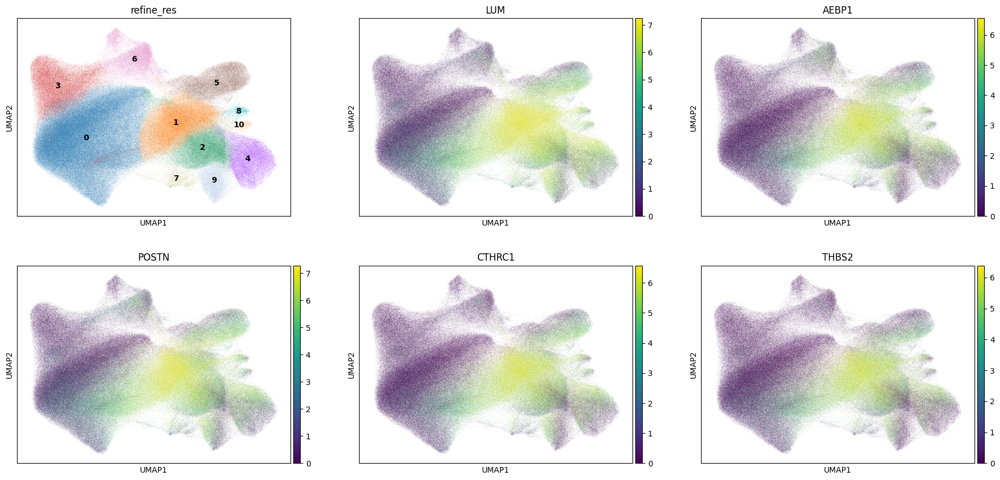

In [105]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [106]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 1: 74746
Percentage of cells in cluster 1: 13.0


In [107]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'CAF'

### 5.3. Cluster 2

In [108]:
cluster_id = '2'

In [109]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,62.1
1,NA,NA,NA,18.2
2,Fibroblast,CAF,normal_cell,10.4
3,T,T,normal_cell,3.8
4,Epithelial,Mammary_basal_and_luminal_cell,normal_cell,2.1


In [110]:
top_ranked_genes[cluster_id]

0    FCER1G
1       LYZ
2      SRGN
3       CD4
4      AIF1
Name: 2, dtype: object

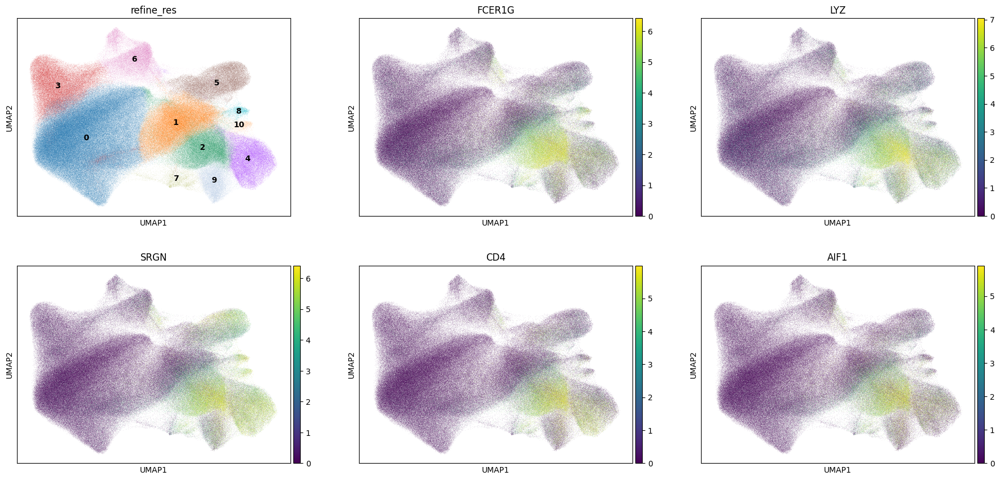

In [111]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [112]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 2: 56182
Percentage of cells in cluster 2: 9.8


In [113]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Monocyte/Macrophage'

### 5.4. Cluster 3

In [114]:
cluster_id = '3'

In [115]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Mammary_luminal_cell,cancer_cell,87.3
1,Epithelial,Mammary_basal_and_luminal_cell,normal_cell,5.6
2,Epithelial,Mammary_basal_cell_(=myoepithelial),normal_cell,3.8
3,Epithelial,Proliferating_mammary_luminal_epithelial_cell,cancer_cell,2.3
4,NA,NA,NA,0.7


In [116]:
top_ranked_genes[cluster_id]

0        FLNB
1    ANKRD30A
2        MLPH
3       GATA3
4     TACSTD2
Name: 3, dtype: object

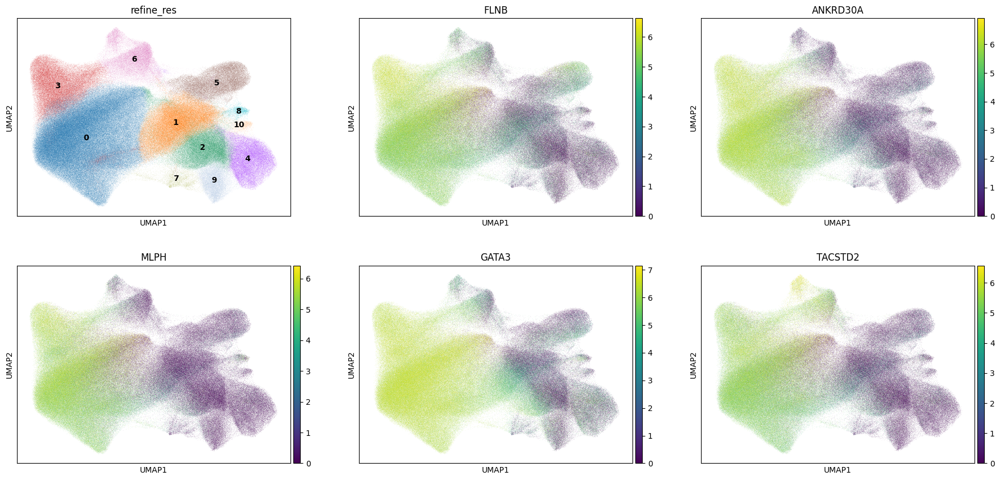

In [117]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [118]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 3: 55821
Percentage of cells in cluster 3: 9.7


In [119]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Mammary_luminal_cell'

### 5.5. Cluster 4

In [120]:
cluster_id = '4'

In [121]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,T,T,normal_cell,89.8
1,NA,NA,NA,4.5
2,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,1.9
3,Fibroblast,CAF,normal_cell,1.9
4,B,B,normal_cell,1.1


In [122]:
top_ranked_genes[cluster_id]

0     CD3E
1    PTPRC
2     TRAC
3     SRGN
4     CD96
Name: 4, dtype: object

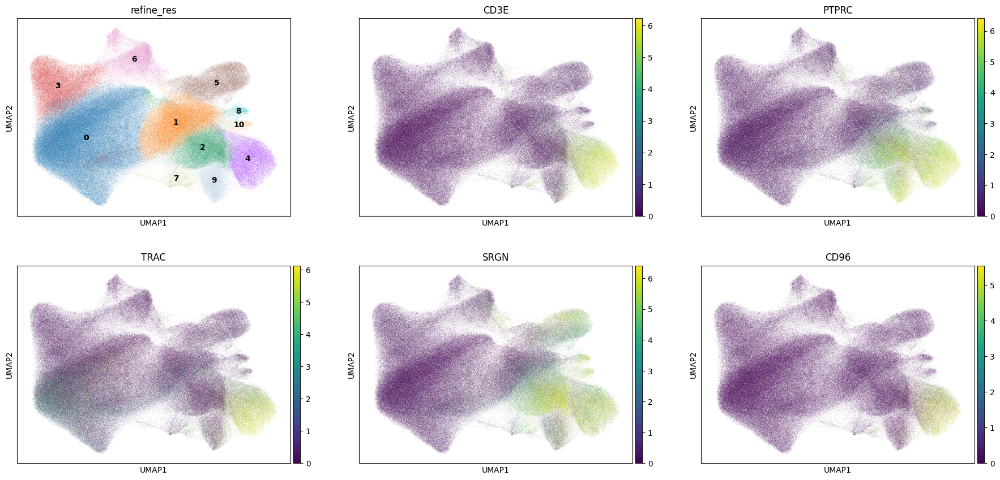

In [123]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [124]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 4: 36809
Percentage of cells in cluster 4: 6.4


In [125]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'T'

### 5.6. Cluster 5

In [4]:
cluster_id = '5'

In [127]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Endothelial,Endothelial,normal_cell,55.7
1,Perivascular,Smooth_muscle_cell_and_pericyte,normal_cell,30.2
2,Fibroblast,CAF,normal_cell,6.1
3,NA,NA,NA,5.0
4,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,0.9


In [128]:
top_ranked_genes[cluster_id]

0    SPARCL1
1       AQP1
2       CAV1
3       RGS5
4       CD93
Name: 5, dtype: object

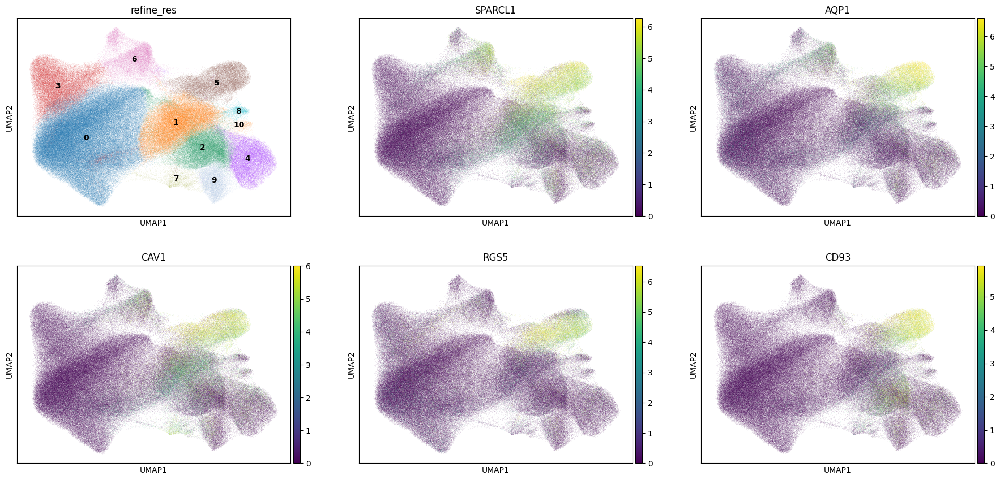

In [129]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [130]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 5: 34260
Percentage of cells in cluster 5: 6.0


In [5]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Blood_vessel'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Endothelial_Pericyte_Smooth_muscle'

### 5.7. Cluster 6

In [132]:
cluster_id = '6'

In [133]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Mammary_basal_cell_(=myoepithelial),normal_cell,71.1
1,Epithelial,Mammary_luminal_cell,cancer_cell,17.5
2,NA,NA,NA,3.5
3,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,3.3
4,Fibroblast,CAF,normal_cell,1.7


In [134]:
top_ranked_genes[cluster_id]

0      DST
1    KRT14
2     MYLK
3      PTN
4    SFRP1
Name: 6, dtype: object

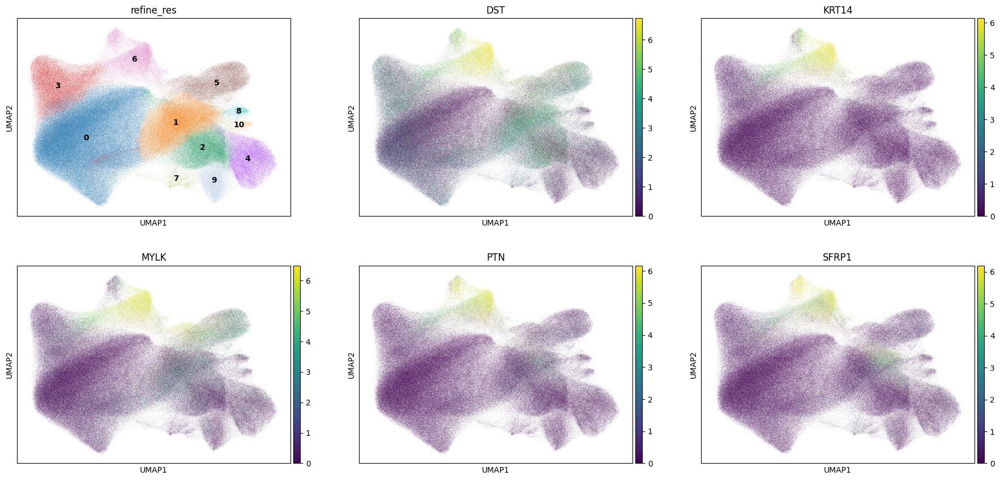

In [135]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [136]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 6: 26787
Percentage of cells in cluster 6: 4.7


In [137]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Mammary_basal_cell_(=myoepithelial)'

### 5.8. Cluster 7

In [138]:
cluster_id = '7'

In [139]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Fibroblast,CAF,normal_cell,18.0
1,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,17.7
2,T,T,normal_cell,14.7
3,Adipocyte,Adipocyte,normal_cell,13.8
4,B,B,normal_cell,10.5


In [140]:
top_ranked_genes[cluster_id]

0    ADIPOQ
1      GPX3
2     ADH1B
3      G0S2
4       LPL
Name: 7, dtype: object

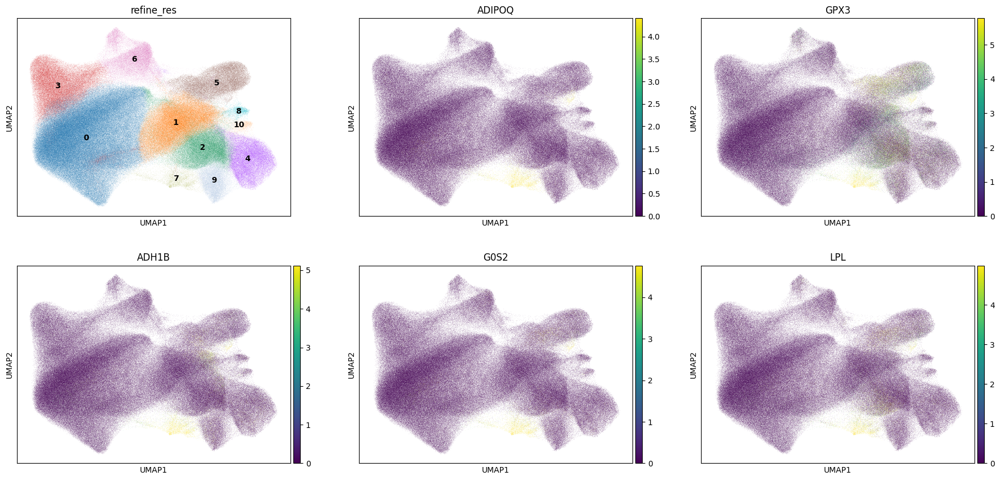

In [141]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [142]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 7: 5134
Percentage of cells in cluster 7: 0.9


In [143]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Adipocyte'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Adipocyte'

### 5.9. Cluster 8

In [144]:
cluster_id = '8'

In [145]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Mast,Mast,normal_cell,66.5
1,Fibroblast,CAF,normal_cell,12.6
2,NA,NA,NA,11.8
3,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,4.5
4,Perivascular,Smooth_muscle_cell_and_pericyte,normal_cell,1.4


In [146]:
top_ranked_genes[cluster_id]

0      CPA3
1    TPSAB1
2       KIT
3      SRGN
4      ZEB2
Name: 8, dtype: object

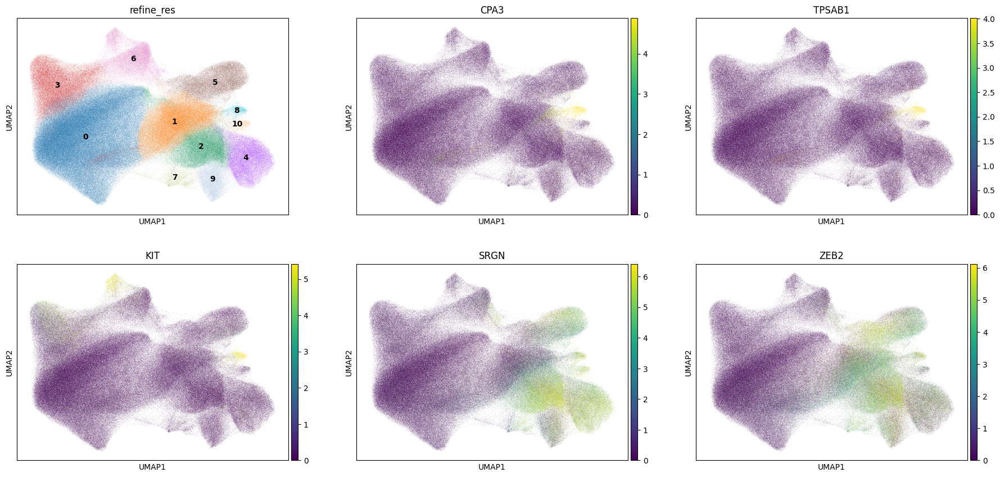

In [147]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [148]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 8: 2936
Percentage of cells in cluster 8: 0.5


In [149]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Mast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Mast'

### 5.10. Cluster 9

In [152]:
cluster_id = '9'

In [154]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,B,B,normal_cell,81.9
1,NA,NA,NA,8.3
2,T,T,normal_cell,3.9
3,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,2.7
4,Fibroblast,CAF,normal_cell,2.4


In [155]:
top_ranked_genes[cluster_id]

0    MS4A1
1    BANK1
2     CD52
3    PTPRC
4     SELL
Name: 9, dtype: object

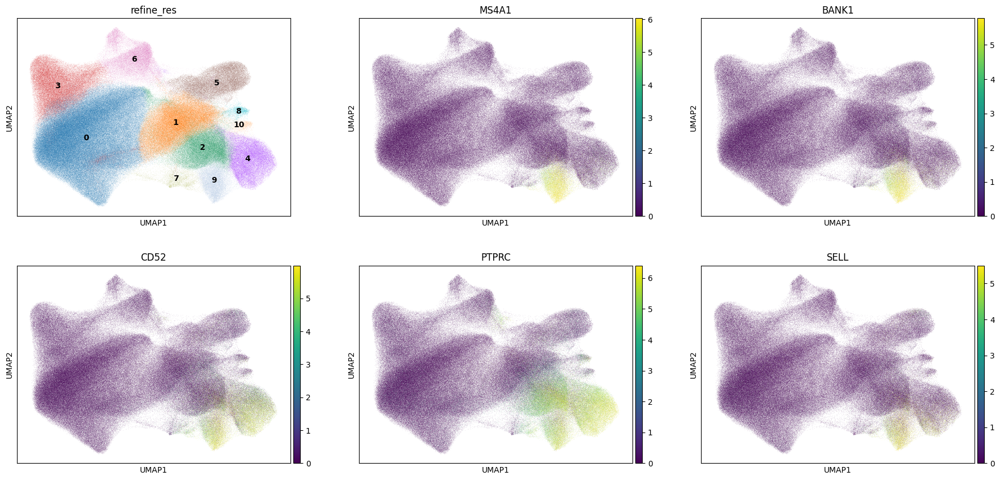

In [156]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [157]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 9: 16755
Percentage of cells in cluster 9: 2.9


In [158]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'B'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'B'

### 5.11. Cluster 10

In [159]:
cluster_id = '10'

In [160]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,B,B,normal_cell,61.0
1,Fibroblast,CAF,normal_cell,17.5
2,NA,NA,NA,7.9
3,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,5.4
4,T,T,normal_cell,4.2


In [161]:
top_ranked_genes[cluster_id]

0      MZB1
1    SLAMF7
2     ITM2C
3    TENT5C
4    SEC11C
Name: 10, dtype: object

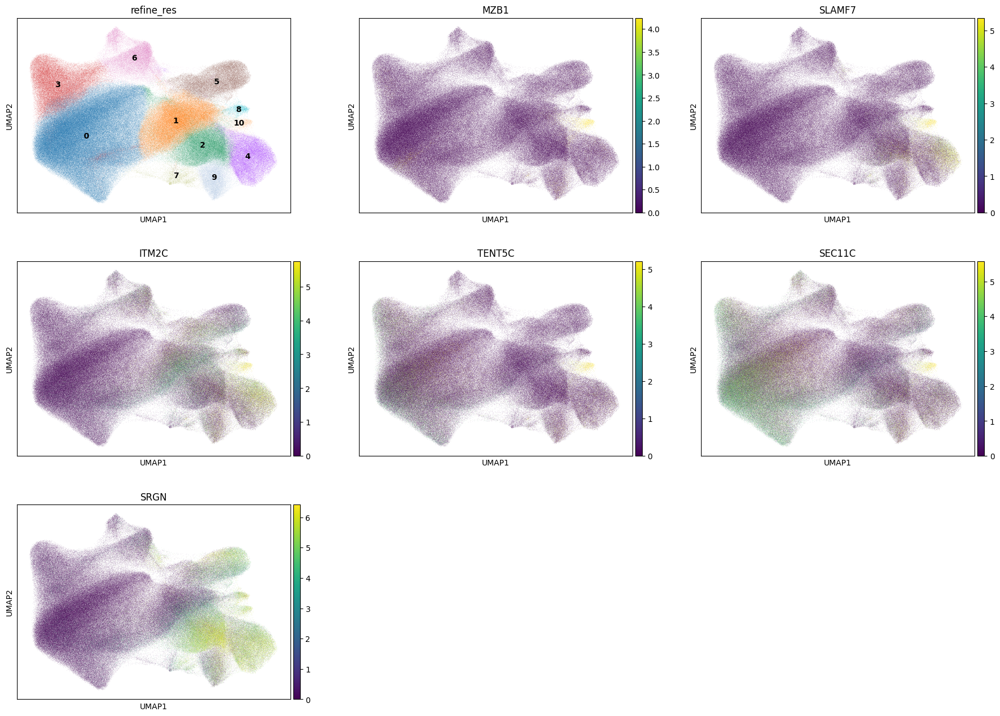

In [162]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5]+['SRGN'], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [163]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 10: 2792
Percentage of cells in cluster 10: 0.5


In [164]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Plasma'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Plasma'

## 6. Cancer cells

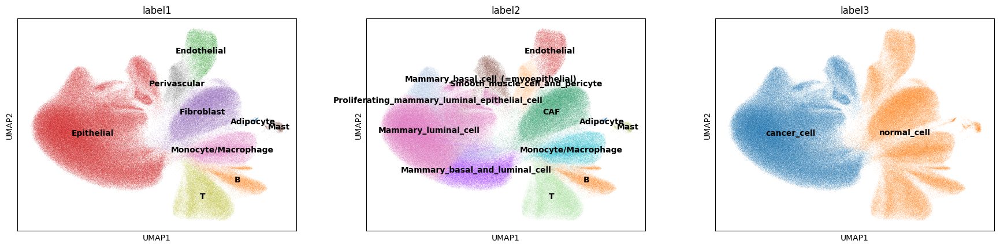

In [5]:
sc.pl.umap(adata_nuclei, color=['label1', 'label2', 'label3'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

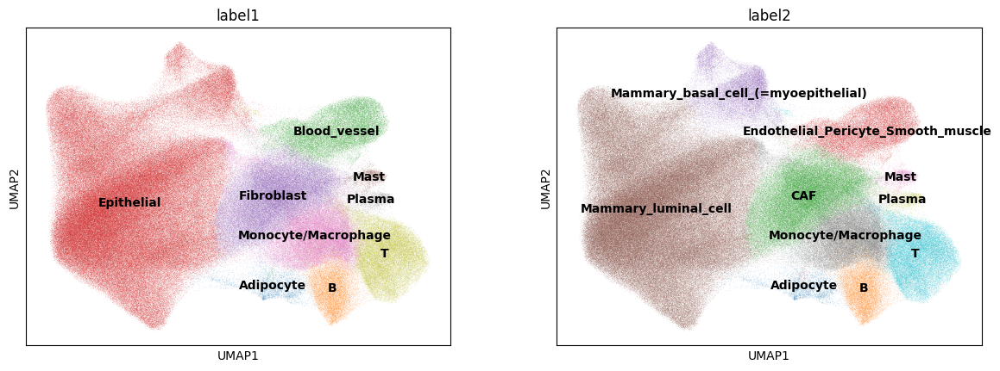

In [6]:
sc.pl.umap(adata_cells, color=['label1', 'label2'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [7]:
# Cancer cells
adata_cells.obs['label3'] = 'normal_cell'
adata_cells.obs.loc[adata_cells.obs['label1'].isin(['Epithelial']), 'label3'] = 'cancer_cell'

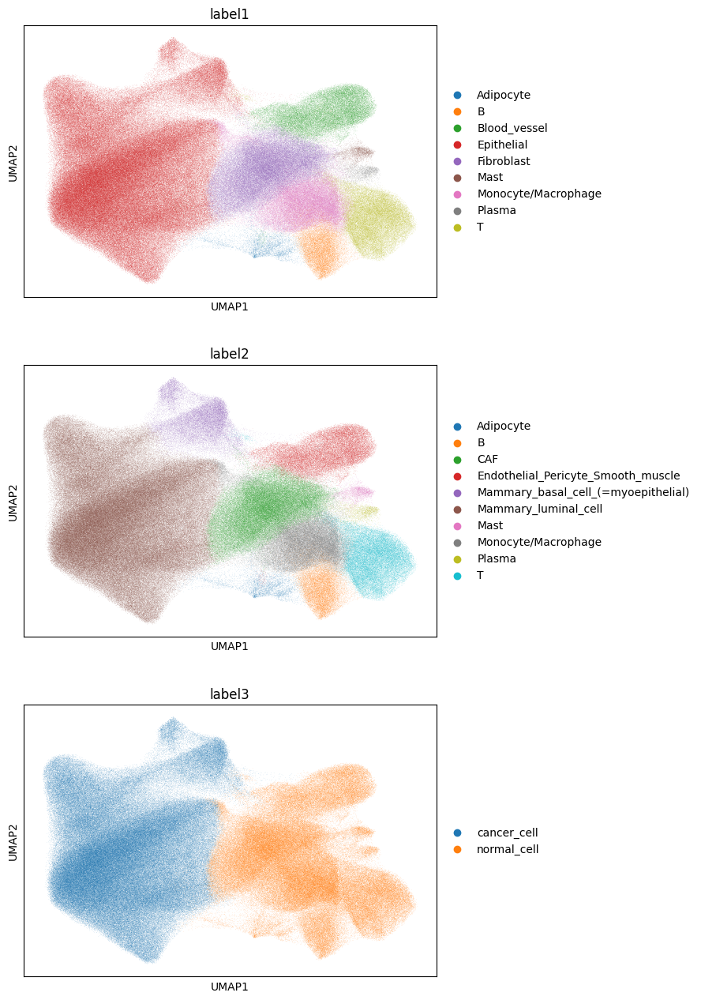

In [8]:
sc.pl.umap(adata_cells, color=['label1', 'label2', 'label3'], ncols=1)

## 7. Save

In [9]:
adata_cells.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,total_counts,cell_area,nucleus_area,region,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,label3
0,aaaaaaaa-1,57,0,0,0,57,277.936719,29.216094,cell_labels,0,4,2,0,Epithelial,Mammary_luminal_cell,cancer_cell
1,aaaaaaab-1,88,0,0,0,88,687.955469,37.840938,cell_labels,3,3,13,3,Epithelial,Mammary_luminal_cell,cancer_cell
2,aaaaaaac-1,190,0,0,0,190,223.342813,29.216094,cell_labels,5,1,9,5,Blood_vessel,Endothelial_Pericyte_Smooth_muscle,normal_cell
3,aaaaaaad-1,146,0,0,0,146,96.995625,21.900781,cell_labels,0,0,0,0,Epithelial,Mammary_luminal_cell,cancer_cell
4,aaaaaaae-1,203,0,0,0,203,115.012969,44.162813,cell_labels,0,0,0,0,Epithelial,Mammary_luminal_cell,cancer_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
576958,aaaimnlo-1,90,0,0,0,90,50.981406,31.654531,cell_labels,0,0,3,0,Epithelial,Mammary_luminal_cell,cancer_cell
576959,aaaimnlp-1,96,0,0,0,96,47.007656,32.106094,cell_labels,0,0,0,0,Epithelial,Mammary_luminal_cell,cancer_cell
576960,aaaimnma-1,178,0,0,0,178,90.222188,59.741719,cell_labels,0,0,0,0,Epithelial,Mammary_luminal_cell,cancer_cell
576961,aaaimnmb-1,50,0,0,0,50,83.584219,13.953281,cell_labels,3,3,3,3,Epithelial,Mammary_luminal_cell,cancer_cell


In [10]:
adata_cells.write_h5ad(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")
# adata_cells = sc.read_h5ad(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")